# Predictions

#### Content:
- Visualize single prediction (get recording, show which fragment is selected as the loudest one, show predicted class and true label, use lime to explain the result (?))
- Inspect wrongly classified recordings
- Listen to the wrongly classified samples

## Visualize single prediction


### Load dataset, prepare dataloader

In [15]:
from birdclassification.preprocessing.filtering import filter_recordings_30
from birdclassification.visualization.plots import plot_selected_waveform, plot_torch_spectrogram, plot_torch_waveform
from torch.utils.data import DataLoader
import torch
from sklearn.model_selection import train_test_split
from birdclassification.training.dataset import Recordings30
from birdclassification.training.cnn_training_torch.CNN_model import CNNNetwork
from birdclassification.preprocessing.spectrogram import generate_mel_spectrogram_seq
import torchaudio
from birdclassification.preprocessing.utils import mix_down
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, classification_report
import seaborn as sns
import IPython.display as ipd

In [2]:
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
SEED = 123
RECORDINGS_DIR = '/media/jacek/E753-A120/recordings_30'
NOISES_DIR = '/path/to/noise/dataset'
SAMPLE_RATE = 32000
NUM_SAMPLES = SAMPLE_RATE * 3
BATCH_SIZE = 64
LEARNING_RATE = 0.0001
EPOCHS = 5
NUM_WORKERS = 4
df = filter_recordings_30("../../data/xeno_canto_recordings.csv", "../../data/bird-list-extended.csv", )

train_df, test_val_df = train_test_split(df, stratify=df['Latin name'], test_size=0.2, random_state=SEED)
val_df, test_df = train_test_split(test_val_df, stratify=test_val_df['Latin name'], test_size=0.5, random_state=SEED)

train_ds = Recordings30(train_df, recording_dir=RECORDINGS_DIR, noises_dir=NOISES_DIR, sample_rate=SAMPLE_RATE, device=DEVICE)
val_ds = Recordings30(val_df, recording_dir=RECORDINGS_DIR, noises_dir=NOISES_DIR, sample_rate=32000, device=DEVICE)
test_ds = Recordings30(test_df, recording_dir=RECORDINGS_DIR, noises_dir=NOISES_DIR, sample_rate=32000, device=DEVICE)

train_dl = DataLoader(train_ds, batch_size=BATCH_SIZE, num_workers=NUM_WORKERS)
val_dl = DataLoader(val_ds, batch_size=BATCH_SIZE, num_workers=NUM_WORKERS)
test_dl = DataLoader(test_ds, batch_size=BATCH_SIZE, num_workers=NUM_WORKERS)

/home/jacek/Documents/PycharmProjects/Bird-classification-model/birdclassification/preprocessing/filtering.py:72: DtypeWarning: Columns (10,39,43,44,45,46,47,48) have mixed types. Specify dtype option on import or set low_memory=False.
  recordings = pd.read_csv(filepath_recordings)


## Prepare the model

In [3]:
MODEL_PATH = '/home/jacek/cnn dropout2d_batchnorm2d_random_loudest/model_20231226_002135_19'
cnn = CNNNetwork()
cnn.to(DEVICE)
cnn.load_state_dict(torch.load(MODEL_PATH ))
cnn.eval()

CNNNetwork(
  (conv1): Sequential(
    (0): Conv2d(1, 16, kernel_size=(3, 3), stride=(1, 1), padding=(2, 2))
    (1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (4): Dropout2d(p=0.2, inplace=False)
  )
  (conv2): Sequential(
    (0): Conv2d(16, 32, kernel_size=(3, 3), stride=(1, 1), padding=(2, 2))
    (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (4): Dropout2d(p=0.2, inplace=False)
  )
  (conv3): Sequential(
    (0): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(2, 2))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (4): Dropout2d(p=0.2, inplace=Fals

## Visualize single prediction

### Selecting loudest 3 seconds

In [4]:
index = 0
map = test_ds.get_mapping()

-----------------------------------------------------------------------------
SOURCE FILE: 
-----------------------------------------------------------------------------
Original file:  /media/jacek/E753-A120/recordings_30/Asio otus/138820.mp3
Length:  63.146 [s]
-----------------------------------------------------------------------------


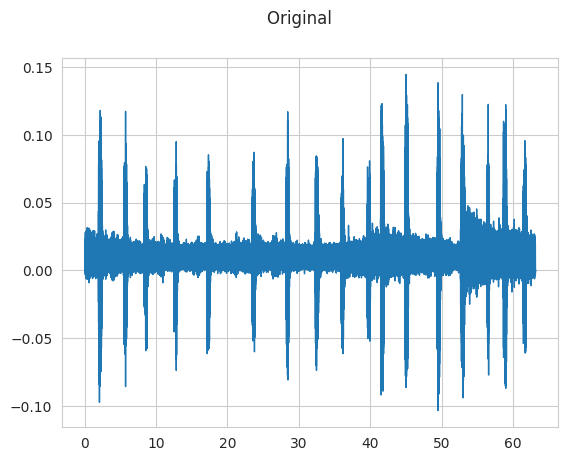

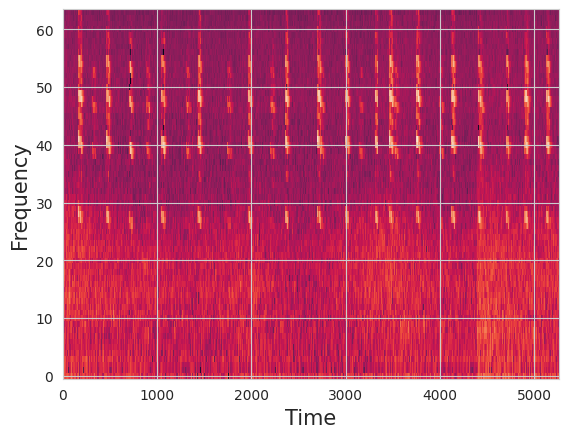

In [5]:
print("-----------------------------------------------------------------------------")
print("SOURCE FILE: ")
print("-----------------------------------------------------------------------------")
filepath = test_ds.get_filepath(index)
print("Original file: ", filepath)
original_waveform, sr = torchaudio.load(filepath)
original_waveform = mix_down(original_waveform)
print("Length: ", original_waveform.shape[1]/sr, "[s]")
print("-----------------------------------------------------------------------------\n")
plot_torch_waveform(original_waveform, sr, title = "Original ")
original_spectrogram = generate_mel_spectrogram_seq(y=original_waveform.to(DEVICE), sr=SAMPLE_RATE, n_fft=512, hop_length=384, device=DEVICE)
original_spectrogram = original_spectrogram.squeeze()
plot_torch_spectrogram(original_spectrogram.to('cpu'))

-----------------------------------------------------------------------------
LOUDEST FRAGMENT FILE: 
-----------------------------------------------------------------------------
Length:  3.0 [s]
-----------------------------------------------------------------------------


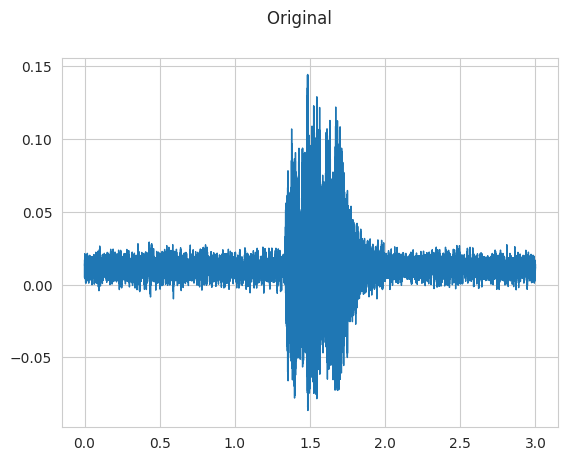

In [6]:
cnn.eval()
with torch.no_grad():
    print("-----------------------------------------------------------------------------")
    print("LOUDEST FRAGMENT FILE: ")
    print("-----------------------------------------------------------------------------")
    waveform, label = test_ds[index]
    print("Length: ", waveform.shape[1]/sr, "[s]")
    print("-----------------------------------------------------------------------------")

    spectrogram = generate_mel_spectrogram_seq(y=waveform.to(DEVICE), sr=SAMPLE_RATE, n_fft=512, hop_length=384, device=DEVICE)
    spectrogram = spectrogram.squeeze()
    plot_torch_waveform(waveform, sr, title = "Original ")
    

### Prediction

Prediction:  Asio otus


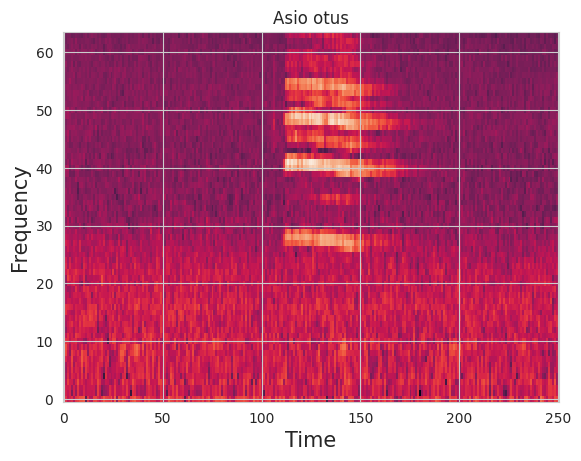

In [7]:
cnn.eval()
with torch.no_grad():
    validation_output = cnn(spectrogram.reshape(1, 1, 64, 251))
    predictions = torch.max(validation_output, dim=1)[1].data.squeeze()
    label = train_ds.get_mapping()[predictions.item()]
    plot_torch_spectrogram(spectrogram.to('cpu'), title=label)

print("Prediction: ", label)

## Batch predictions

In [8]:
batch = next(iter(test_dl)) 
fig, ax = plt.subplots(nrows=32, ncols=2, figsize=(50, 600))


spectrogram = generate_mel_spectrogram_seq(y=batch[0].to(DEVICE), sr=SAMPLE_RATE, n_fft=512, hop_length=384, device=DEVICE)
spectrogram = spectrogram.unsqueeze(dim = 1)

true_label = batch[1]

with torch.no_grad():
    validation_output = cnn(spectrogram)
    prediction  = torch.max(validation_output, dim=1)[1].data.squeeze()



for i in range(64):
    img = spectrogram[i].squeeze()
    plot_torch_spectrogram(img.to("cpu"), ax = ax[i//2][i%2])
    ax[i//2][i%2].title.set_text(f"True label: {map[int(true_label[i])]}     Prediction: {map[int(prediction[i])]}\n")
    ax[i//2][i%2].title.set_fontsize(20)
 



In [9]:
prediction = prediction.to("cpu")

In [10]:
true_label = true_label.to("cpu")

In [11]:
x = true_label == prediction
x

tensor([ True,  True,  True, False,  True,  True, False, False,  True,  True,
         True,  True, False,  True,  True,  True,  True, False,  True, False,
        False,  True, False, False,  True,  True,  True, False, False,  True,
         True,  True, False,  True,  True,  True, False,  True,  True,  True,
         True, False,  True,  True,  True,  True,  True,  True, False,  True,
        False,  True,  True, False,  True,  True,  True, False,  True, False,
        False,  True, False,  True])

In [12]:
import torch
indices = torch.nonzero(x == False)
indices.reshape(-1)

tensor([ 3,  6,  7, 12, 17, 19, 20, 22, 23, 27, 28, 32, 36, 41, 48, 50, 53, 57,
        59, 60, 62])

In [17]:
for i, waveform in enumerate(batch[0]):
    print(f"True label: {map[int(true_label[i])]}     Prediction: {map[int(prediction[i])]}\n")
    ipd.display(ipd.Audio(data=waveform, rate=SAMPLE_RATE))

True label: Asio otus     Prediction: Asio otus


True label: Turdus merula     Prediction: Turdus merula


True label: Garrulus glandarius     Prediction: Garrulus glandarius


True label: Turdus torquatus     Prediction: Alauda arvensis


True label: Hirundo rustica     Prediction: Hirundo rustica


True label: Turdus merula     Prediction: Turdus merula


True label: Apus apus     Prediction: Garrulus glandarius


True label: Buteo buteo     Prediction: Corvus corax


True label: Hirundo rustica     Prediction: Hirundo rustica


True label: Garrulus glandarius     Prediction: Garrulus glandarius


True label: Buteo buteo     Prediction: Buteo buteo


True label: Anas platyrhynchos     Prediction: Anas platyrhynchos


True label: Ciconia ciconia     Prediction: Carduelis carduelis


True label: Corvus corax     Prediction: Corvus corax


True label: Carduelis carduelis     Prediction: Carduelis carduelis


True label: Dendrocopos major     Prediction: Dendrocopos major


True label: Corvus corax     Prediction: Corvus corax


True label: Picus viridis     Prediction: Columba livia


True label: Turdus torquatus     Prediction: Turdus torquatus


True label: Cygnus olor     Prediction: Alauda arvensis


True label: Turdus merula     Prediction: Turdus viscivorus


True label: Sturnus vulgaris     Prediction: Sturnus vulgaris


True label: Hirundo rustica     Prediction: Corvus corax


True label: Cygnus olor     Prediction: Phasianus colchicus


True label: Buteo buteo     Prediction: Buteo buteo


True label: Turdus merula     Prediction: Turdus merula


True label: Passer domesticus     Prediction: Passer domesticus


True label: Alauda arvensis     Prediction: Cuculus canorus


True label: Grus grus     Prediction: Corvus corax


True label: Turdus merula     Prediction: Turdus merula


True label: Corvus corax     Prediction: Corvus corax


True label: Alauda arvensis     Prediction: Alauda arvensis


True label: Carduelis carduelis     Prediction: Corvus corax


True label: Alauda arvensis     Prediction: Alauda arvensis


True label: Turdus merula     Prediction: Turdus merula


True label: Turdus merula     Prediction: Turdus merula


True label: Hirundo rustica     Prediction: Passer domesticus


True label: Alauda arvensis     Prediction: Alauda arvensis


True label: Dendrocopos major     Prediction: Dendrocopos major


True label: Turdus merula     Prediction: Turdus merula


True label: Sturnus vulgaris     Prediction: Sturnus vulgaris


True label: Anas platyrhynchos     Prediction: Turdus merula


True label: Corvus corax     Prediction: Corvus corax


True label: Alauda arvensis     Prediction: Alauda arvensis


True label: Turdus merula     Prediction: Turdus merula


True label: Apus apus     Prediction: Apus apus


True label: Hirundo rustica     Prediction: Hirundo rustica


True label: Corvus cornix     Prediction: Corvus cornix


True label: Picus viridis     Prediction: Hirundo rustica


True label: Turdus merula     Prediction: Turdus merula


True label: Turdus torquatus     Prediction: Hirundo rustica


True label: Turdus merula     Prediction: Turdus merula


True label: Anas platyrhynchos     Prediction: Anas platyrhynchos


True label: Turdus viscivorus     Prediction: Buteo buteo


True label: Pica pica     Prediction: Pica pica


True label: Carduelis carduelis     Prediction: Carduelis carduelis


True label: Carduelis carduelis     Prediction: Carduelis carduelis


True label: Turdus merula     Prediction: Dendrocopos major


True label: Passer domesticus     Prediction: Passer domesticus


True label: Turdus torquatus     Prediction: Dendrocopos major


True label: Turdus merula     Prediction: Corvus frugilegus


True label: Alauda arvensis     Prediction: Alauda arvensis


True label: Garrulus glandarius     Prediction: Carduelis carduelis


True label: Turdus merula     Prediction: Turdus merula
